## MODELS POOLED, UNPOOLED, HIERARCHICAL

#### Plot the distribution of the data

In [177]:
import pandas as pd
import os
import pymc as pm
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import warnings

# Suppress all warnings
warnings.filterwarnings('ignore')
data = pd.read_csv('cleaned_football_data.csv')

# Split data by league and season
serie_a_data = data[data['League'] == 'Serie A']
pl_data = data[data['League'] == 'Premier League']

display(serie_a_data.head())
display(pl_data.head())

,Div,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,...,AvgA,PSCH,PSCD,PSCA,Season,League,LBH,LBD,LBA,HomeWin
3040,I1,24/08/2019,Parma,Juventus,0,1,A,0.0,1.0,A,...,1.31,9.60,5.20,1.37,2019,Serie A,2.87875,4.095724,5.192526,0
3041,I1,24/08/2019,Fiorentina,Napoli,3,4,A,1.0,2.0,A,...,1.76,4.52,3.72,1.85,2019,Serie A,2.87875,4.095724,5.192526,0
3042,I1,25/08/2019,Udinese,Milan,1,0,H,0.0,0.0,D,...,2.06,4.03,3.43,2.04,2019,Serie A,2.87875,4.095724,5.192526,1
3043,I1,25/08/2019,Cagliari,Brescia,0,1,A,0.0,0.0,D,...,4.45,1.83,3.67,4.75,2019,Serie A,2.87875,4.095724,5.192526,0
3044,I1,25/08/2019,Roma,Genoa,3,3,D,2.0,2.0,D,...,7.13,1.75,3.69,5.32,2019,Serie A,2.87875,4.095724,5.192526,0


,Div,Date,HomeTeam,AwayTeam,FTHG,FTAG,FTR,HTHG,HTAG,HTR,...,AvgA,PSCH,PSCD,PSCA,Season,League,LBH,LBD,LBA,HomeWin
0,E0,09/08/2019,Liverpool,Norwich,4,1,H,4.0,0.0,H,...,19.83,1.14,10.43,19.63,2019,Premier League,2.953658,4.099487,5.155421,1
1,E0,10/08/2019,West Ham,Man City,0,5,A,0.0,1.0,A,...,1.25,11.11,6.68,1.27,2019,Premier League,2.953658,4.099487,5.155421,0
2,E0,10/08/2019,Bournemouth,Sheffield United,1,1,D,0.0,0.0,D,...,3.83,1.98,3.67,4.06,2019,Premier League,2.953658,4.099487,5.155421,0
3,E0,10/08/2019,Burnley,Southampton,3,0,H,0.0,0.0,D,...,2.78,2.71,3.19,2.90,2019,Premier League,2.953658,4.099487,5.155421,1
4,E0,10/08/2019,Crystal Palace,Everton,0,0,D,0.0,0.0,D,...,2.40,3.37,3.45,2.27,2019,Premier League,2.953658,4.099487,5.155421,0


In [178]:
data['goals_per_match'] = data['FTHG'] + data['FTAG']

In [179]:
goals_per_match_mean =data[['FTHG', 'FTAG']].mean(axis=1)
goals_per_match_std = data[['FTHG', 'FTAG']].std(axis=1)

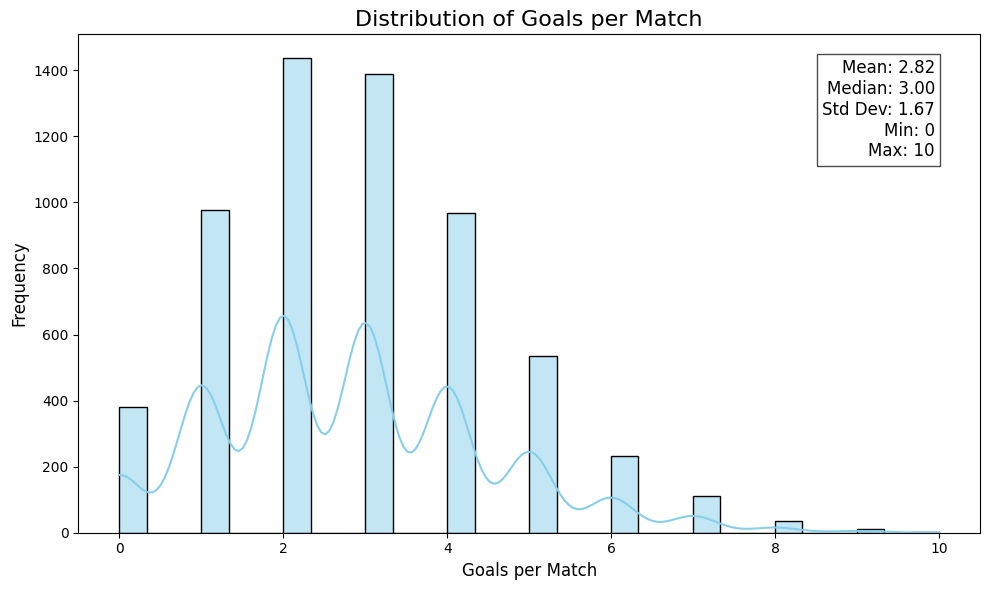

In [180]:
plt.figure(figsize=(10, 6))
goals_per_match = data["goals_per_match"]

sns.histplot(goals_per_match, kde=True, color='skyblue', bins=30)

# Adding titles and labels
plt.title('Distribution of Goals per Match', fontsize=16)
plt.xlabel('Goals per Match', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

# Calculating and displaying interesting statistics
mean_goals = np.mean(goals_per_match)
std_goals = np.std(goals_per_match)
median_goals = np.median(goals_per_match)
min_goals = np.min(goals_per_match)
max_goals = np.max(goals_per_match)

# Displaying the stats on the plot
stats_text = f'Mean: {mean_goals:.2f}\nMedian: {median_goals:.2f}\nStd Dev: {std_goals:.2f}\nMin: {min_goals}\nMax: {max_goals}'
plt.text(0.95, 0.95, stats_text, horizontalalignment='right', verticalalignment='top',
         transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.7))

# Show the plot
plt.tight_layout()
plt.show()

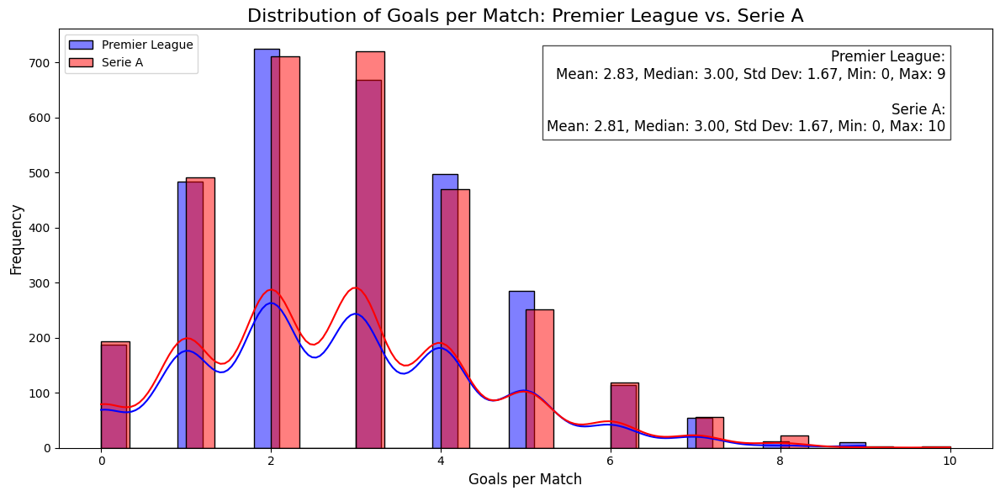

In [181]:
pl_goals_per_match = pl_data['FTHG'] + pl_data['FTAG']
serie_a_goals_per_match = serie_a_data['FTHG'] + serie_a_data['FTAG']

# Calculate statistics for Premier League
pl_mean_goals = pl_goals_per_match.mean()
pl_median_goals = pl_goals_per_match.median()
pl_std_goals = pl_goals_per_match.std()
pl_min_goals = pl_goals_per_match.min()
pl_max_goals = pl_goals_per_match.max()

# Calculate statistics for Serie A
serie_a_mean_goals = serie_a_goals_per_match.mean()
serie_a_median_goals = serie_a_goals_per_match.median()
serie_a_std_goals = serie_a_goals_per_match.std()
serie_a_min_goals = serie_a_goals_per_match.min()
serie_a_max_goals = serie_a_goals_per_match.max()

# Plotting the distribution of goals per match for Premier League and Serie A
plt.figure(figsize=(12, 6))
sns.histplot(pl_goals_per_match, kde=True, color='blue', label='Premier League', bins=30)
sns.histplot(serie_a_goals_per_match, kde=True, color='red', label='Serie A', bins=30)

# Adding titles and labels
plt.title('Distribution of Goals per Match: Premier League vs. Serie A', fontsize=16)
plt.xlabel('Goals per Match', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.legend()

# Displaying the stats on the plot
stats_text = f'Premier League:\nMean: {pl_mean_goals:.2f}, Median: {pl_median_goals:.2f}, Std Dev: {pl_std_goals:.2f}, Min: {pl_min_goals}, Max: {pl_max_goals}\n\nSerie A:\nMean: {serie_a_mean_goals:.2f}, Median: {serie_a_median_goals:.2f}, Std Dev: {serie_a_std_goals:.2f}, Min: {serie_a_min_goals}, Max: {serie_a_max_goals}'
plt.text(0.95, 0.95, stats_text, horizontalalignment='right', verticalalignment='top',
            transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='white', alpha=0.7))

# Show the plot
plt.tight_layout()
plt.show()



In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'data' DataFrame is already loaded as in the previous code
plt.figure(figsize=(10, 6))
sns.histplot(data["FTHG"], kde=True, color='skyblue', bins=30)

# Adding titles and labels
plt.title('Distribution of Total Home Goals per Match (FTHG)', fontsize=16)
plt.xlabel('Total Home Goals per Match', fontsize=12)
plt.ylabel('Frequency', fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()

#### Choice of the prior based on online checks

- link to source Serie A: [soccerzz.com](https://www.soccerzz.com/competition/serie-a/10/stats)
- link to source Premier League: [soccerzz.com](https://www.soccerzz.com/competition/premier-league/4/stats)


The general average for home team goals in European football leagues tends to range from 0 to 3.5 goals per game.

μ + 2$\sigma$ = 3.5

1.75 + 2$\sigma$ = 3.5

$\sigma$ = $\frac{1.75}{2}$ = 0.875


In [182]:
goals_per_match_mean = 1.75
# using 2 std range
goals_per_match_std = 0.875

# The resulting Unpooled model
\begin{equation}
\begin{array}{lrl}
& \lambda_{\text{season,league}} & \sim HN(0.875) \; \text{(Poisson rate for each season-league group)} \\
\\
& y_{ij} & \sim \text{Poisson}(\lambda_{\text{season,league}}) \; \text{(observed goals for each match in each group)} \\
\end{array}
\end{equation}



### Explanation:

- $\lambda_{\text{season,league}}$ is the goal-scoring rate for each specific **season-league** combination, modeled with a **HalfNormal** prior with a scale of 0.875.
- $\ y_{ij}$  represents the observed number of goals scored in match i for team j in the specific season-league combination, modeled using a **Poisson** distribution with mean $\lambda_{\text{season,league}}$.
- The model assumes that the goal-scoring rates for different season-league combinations are independent, and each combination has its own goal-scoring rate drawn from the HalfNormal prior.

In [183]:
# prior predictive check to set the sigma of unpooled model
from scipy.stats import norm, halfnorm

# return the percentile 1, 55, 99 of the sampled data.
def test_sigma(half_normal_scale):
  mu_s = norm.rvs(loc = 1.75, scale = 0.875, size = 10000)
  s_s = halfnorm.rvs(scale = half_normal_scale, size = 10000)
  y_s = norm.rvs(loc = mu_s, scale = s_s)
  pc = np.percentile(y_s, q=np.array([1,  50, 99]))
  return pc

# the sigma of the pooled model yields too many values outside the domain
print("scale = 0.3: " + str(test_sigma(half_normal_scale=0.3))) # too small
print("scale = 1.5: " + str(test_sigma(half_normal_scale=1.5))) # too large
print("scale = 1.2: " + str(test_sigma(half_normal_scale=1.2))) # too large
print("scale = 0.875: " + str(test_sigma(half_normal_scale=0.875))) # ok


scale = 0.3: [-0.44519927  1.74163522  3.83030786]
scale = 1.5: [-3.11223039  1.7490128   6.4791015 ]
scale = 1.2: [-2.20315326  1.73967702  5.58645918]
scale = 0.875: [-1.40639507  1.7562679   4.85558657]


In [184]:
# Group the data by team (HomeTeam)
grouped_data = data.groupby('HomeTeam')['FTHG']

with pm.Model() as unpooled_model:
    lambda_dict = {}

    # Loop through each group (team)
    for team, group_data in grouped_data:
        # Prior for the Poisson rate (lambda) for each team
        lambda_dict[team] = pm.HalfNormal(f'lambda_{team}', sigma=0.875)

        # Likelihood for the goals in each match for each team (Poisson distribution)
        pm.Poisson(f'y_{team}', mu=lambda_dict[team], observed=group_data)

    # Sampling from the model
    unpooled_trace = pm.sample(10_000)


Output()

Output()

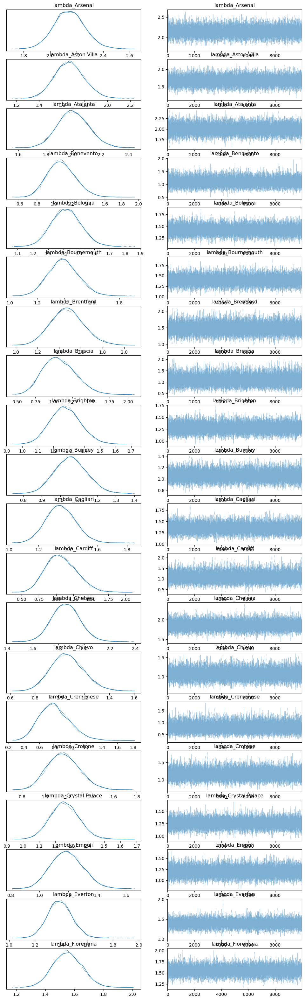

In [185]:
pm.plot_trace(unpooled_trace)
plt.show()

In [186]:
pm.summary(unpooled_trace)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
lambda_Arsenal,2.145,0.117,1.920,2.358,0.001,0.000,41534.0,14393.0,1.0
lambda_Aston Villa,1.667,0.128,1.427,1.910,0.001,0.000,43259.0,14537.0,1.0
lambda_Atalanta,1.998,0.113,1.790,2.213,0.001,0.000,44058.0,13830.0,1.0
lambda_Benevento,1.091,0.164,0.793,1.403,0.001,0.001,35273.0,14166.0,1.0
lambda_Bologna,1.417,0.096,1.238,1.593,0.000,0.000,46515.0,14594.0,1.0
...,...,...,...,...,...,...,...,...,...
lambda_Verona,1.220,0.103,1.031,1.418,0.000,0.000,43397.0,15140.0,1.0
lambda_Watford,1.221,0.113,1.010,1.430,0.001,0.000,40027.0,14982.0,1.0
lambda_West Brom,1.095,0.133,0.840,1.338,0.001,0.000,42679.0,13850.0,1.0
lambda_West Ham,1.482,0.097,1.301,1.664,0.001,0.000,29744.0,14026.0,1.0


# Hierarchical model

In this case, you want to account for differences between teams.

The idea is to model the goal counts for each team, while allowing for some "sharing" of information between teams based on their historical performance (across seasons).


# The resulting hierarhical model

\begin{equation}
\begin{array}{lrl}
& \mu_{\text{global}} & \sim N(1.75, 0.875) \;\;\; \text{(global mean for home goals)} \\
& \sigma_{\text{global}} & \sim HN(1.2)  \;\;\; \text{(global std for home goals)} \\
 \\
 & \mu_j & \sim N( \mu_{\text{global}}, \sigma_{\text{global}}) \;\;\; \text{(team-level means drawn from the global mean)}\\
 & \sigma_{\text{match}} & \sim HN(0.875)  \;\;\; \text{(match-level variability for each team)}  \\
\\
 & y_{ij} & \sim N( \mu_j, \sigma_{\text{match}}) \;\;\; \text{(observed goals for each team in each team)} \hspace{-0.075in}
\\
\end{array}
\end{equation}

In [187]:
goals_per_match_mean = data["FTHG"].mean()
goals_per_match_std = data["FTHG"].std()

# Calculate team-level mean and standard deviation
team_stats = data.groupby("HomeTeam")["FTHG"].agg(["mean", "std"]).reset_index()
team_stats.rename(columns={"mean": "team_mean", "std": "team_std"}, inplace=True)

goals_per_match_mean, goals_per_match_std

(1.5447368421052632, 1.303053696325317)

In [188]:
team_stats

,HomeTeam,team_mean,team_std
0,Arsenal,2.177632,1.352466
1,Aston Villa,1.694737,1.305257
2,Atalanta,2.026316,1.565131
3,Benevento,1.105263,0.952648
4,Bologna,1.427632,1.131148
...,...,...,...
60,Verona,1.228070,1.004724
61,Watford,1.231579,1.066438
62,West Brom,1.105263,1.128909
63,West Ham,1.493421,1.115791


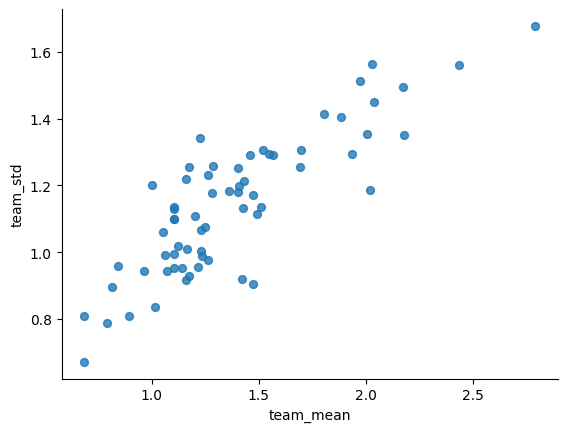

In [189]:
team_stats.plot(kind='scatter', x='team_mean', y='team_std', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

In [190]:
global_mean = team_stats['team_mean'].mean()
global_std = team_stats['team_mean'].std()

global_mean, global_std

(1.3818498168498168, 0.4215682922842497)

In [191]:
from scipy.stats import halfnorm
pd.DataFrame(halfnorm.rvs(scale=1.2, size=10000)).describe()

,0
count,10000.000000
mean,0.957675
std,0.721080
min,0.000236
25%,0.385826
50%,0.810953
75%,1.389211
max,4.587059


In [192]:
# Number of teams and mapping team names to indices
teams = data['HomeTeam'].unique()
n_teams = len(teams)
team_to_idx = {team: idx for idx, team in enumerate(teams)}
team_idx = data['HomeTeam'].map(team_to_idx).values

with pm.Model() as hierarchical_model:

    # Global mean for team-level means
    mu_mu = pm.Normal("mu_mu", mu=1.75, sigma=0.875)  # Global mean for teams (N(1.75, 0.875))

    # Global standard deviation for team-level variability
    sigma_global = pm.HalfNormal("sigma_global", sigma=1.2)  # Global std for team-level means

    # Team-level means, drawn from the global mean with some variance
    mu_team = pm.Normal("mu_team", mu=mu_mu, sigma=sigma_global, shape=n_teams)  # Team-level means

    # Match-level variability (observed goals)
    sigma_match = pm.HalfNormal("sigma_match", sigma=0.875)  # Match-level variability for each team

    # Observed goals (y) for each team in each match
    y_obs = pm.Normal("y_obs", mu=mu_team[team_idx], sigma=sigma_match, observed=data['FTHG'])

    # Sampling from the posterior with automatic tuning
    trace_hierarchical = pm.sample(2000, return_inferencedata=True, tune=1000)

# Convert trace to a dataset for easier querying
posterior = trace_hierarchical.posterior

# Access the mu_team samples
team_samples = posterior['mu_team']

Output()

Output()

In [193]:
import arviz as az

# Convert trace to a dataset for easier querying
posterior = trace_hierarchical.posterior

# Access the `mu_team` samples
team_samples = posterior['mu_team']

# Function to get posterior distribution for a specific team by name
def get_team_distribution(team_name):
    if team_name not in team_to_idx:
        raise ValueError(f"Team '{team_name}' not found in the dataset.")
    team_index = team_to_idx[team_name]
    return team_samples.sel(mu_team_dim_0=team_index)  # Select team-specific samples

# Example: Get posterior distribution for a specific team
team_name = "Arsenal"  # Replace with a team name from your data
team_dist = get_team_distribution(team_name)
print(f"Posterior mean for {team_name}: {team_dist.mean().values}")
print(f"Posterior standard deviation for {team_name}: {team_dist.std().values}")


Posterior mean for Arsenal: 2.133282713321404
Posterior standard deviation for Arsenal: 0.09698450291007309


In [194]:
team_name = "Watford"  # Replace with a team name from your data
team_dist = get_team_distribution(team_name)
print(f"Posterior mean for {team_name}: {team_dist.mean().values}")
print(f"Posterior standard deviation for {team_name}: {team_dist.std().values}")


Posterior mean for Watford: 1.250011153549825
Posterior standard deviation for Watford: 0.11901397744491217


In [195]:
# Posterior summary
summary = pm.summary(trace_hierarchical)
display(summary)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
mu_mu,1.410,0.055,1.307,1.511,0.001,0.000,6309.0,3205.0,1.0
mu_team[0],2.374,0.095,2.198,2.548,0.001,0.001,8392.0,2439.0,1.0
mu_team[1],1.488,0.099,1.299,1.668,0.001,0.001,9046.0,2944.0,1.0
mu_team[2],1.405,0.110,1.209,1.622,0.001,0.001,7459.0,2747.0,1.0
mu_team[3],1.081,0.102,0.884,1.265,0.001,0.001,7529.0,2991.0,1.0
...,...,...,...,...,...,...,...,...,...
mu_team[62],1.205,0.233,0.788,1.671,0.003,0.002,7132.0,3100.0,1.0
mu_team[63],0.923,0.232,0.491,1.342,0.003,0.002,7544.0,2784.0,1.0
mu_team[64],1.137,0.228,0.703,1.552,0.003,0.002,8135.0,2653.0,1.0
sigma_global,0.407,0.042,0.332,0.486,0.001,0.000,5660.0,3492.0,1.0


array([[<Axes: title={'center': 'mu_mu'}>,
        <Axes: title={'center': 'mu_team\n0'}>,
        <Axes: title={'center': 'mu_team\n1'}>,
        <Axes: title={'center': 'mu_team\n2'}>],
       [<Axes: title={'center': 'mu_team\n3'}>,
        <Axes: title={'center': 'mu_team\n4'}>,
        <Axes: title={'center': 'mu_team\n5'}>,
        <Axes: title={'center': 'mu_team\n6'}>],
       [<Axes: title={'center': 'mu_team\n7'}>,
        <Axes: title={'center': 'mu_team\n8'}>,
        <Axes: title={'center': 'mu_team\n9'}>,
        <Axes: title={'center': 'mu_team\n10'}>],
       [<Axes: title={'center': 'mu_team\n11'}>,
        <Axes: title={'center': 'mu_team\n12'}>,
        <Axes: title={'center': 'mu_team\n13'}>,
        <Axes: title={'center': 'mu_team\n14'}>],
       [<Axes: title={'center': 'mu_team\n15'}>,
        <Axes: title={'center': 'mu_team\n16'}>,
        <Axes: title={'center': 'mu_team\n17'}>,
        <Axes: title={'center': 'mu_team\n18'}>],
       [<Axes: title={'center':

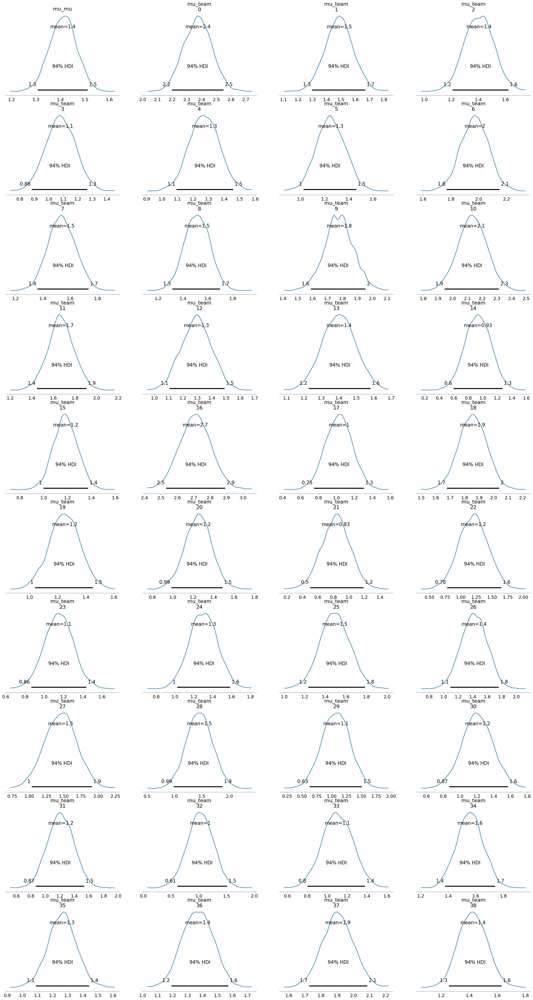

In [196]:
az.summary(trace_hierarchical)
az.plot_posterior(trace_hierarchical)

In [197]:
with hierarchical_model:
    posterior_predictive = pm.sample_posterior_predictive(trace_hierarchical)

Output()

In [198]:
posterior_goals = posterior_predictive['observed_data']

In [199]:
predicted_goals = posterior_predictive["posterior_predictive"]
predicted_goals = predicted_goals['y_obs']

In [200]:
from bokeh.io import output_notebook, show
output_notebook()

<Figure size 1000x600 with 0 Axes>

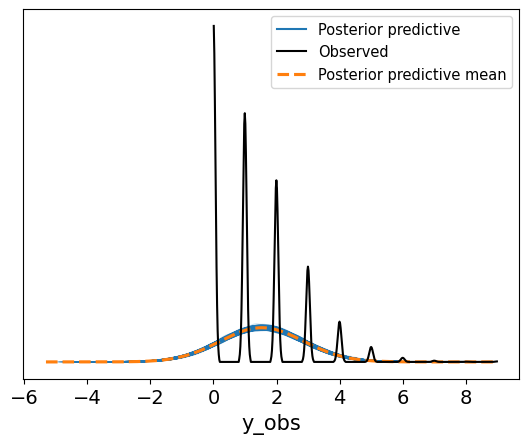

In [201]:
plt.figure(figsize=(10, 6))
az.plot_ppc(posterior_predictive, var_names=["y_obs"])
plt.show()

In [202]:
plt.figure(figsize=(10, 6))
az.plot_ppc(posterior_predictive, var_names=["y_obs"], backend="bokeh")
plt.show()

<Figure size 1000x600 with 0 Axes>

In [203]:

# Assuming traces for both models have been created: trace_unpooled and trace_hier

# Prepare the traces to access using names and assign coordinates for each team
unpooled_trace.posterior = unpooled_trace.posterior.assign_coords(mu_team_dim_0=teams)
trace_hierarchical.posterior = trace_hierarchical.posterior.assign_coords(mu_team_dim_0=teams)


In [204]:
unpooled_trace

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data

In [205]:
trace_hierarchical

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data

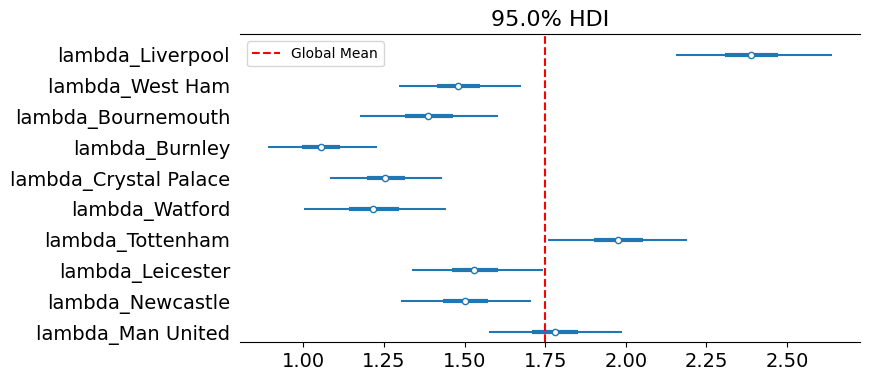

In [209]:
import arviz as az
import matplotlib.pyplot as plt
# Extract the 'lambda_team' values from the unpooled trace for the first 10 teams
lambda_unpooled = [unpooled_trace.posterior[f'lambda_{team}'] for team in teams[:10]]

# Extract the 'mu_team' values from the hierarchical trace for the first 10 teams
mu_team_hierarchical = trace_hierarchical.posterior['mu_team'][:, :10]  # First 10 teams

# Prepare the plot for both models
axes = az.plot_forest(
    [unpooled_trace, trace_hierarchical],  # The traces for unpooled and hierarchical models
    model_names=['Unpooled Model', 'Hierarchical Model'],
    combined=True,
    var_names=[f'lambda_{team}' for team in teams[:10]],  # First 10 teams for unpooled model
    hdi_prob=0.95,
    figsize=(8, 4)
)

# Add a vertical line for the global mean (shrinkage effect in hierarchical model)
grand_mean = data["FTHG"].mean() # Example global mean for home goals
axes[0].axvline(x=grand_mean, color='red', linestyle='--', label='Global Mean')

# Add the global mean to the legend
plt.legend()

# Display the plot
plt.show()


In [210]:
trace_hierarchical

Inference data with groups:
	> posterior
	> sample_stats
	> observed_data

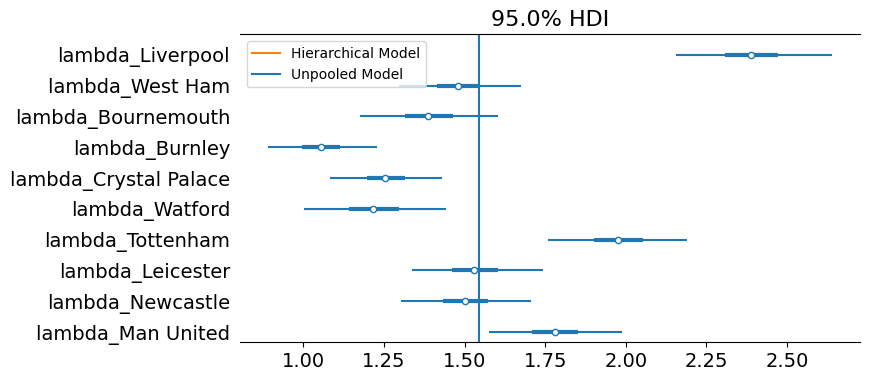

In [211]:
axes = az.plot_forest(
    [unpooled_trace, trace_hierarchical],
    model_names=['Unpooled Model', 'Hierarchical Model'],
    combined=True,
    var_names=[f'lambda_{team}' for team in teams[:10]] + ['mu_team'],
    hdi_prob=0.95,
    figsize=(8, 4)
)

#mean popularity of all songs
grand_mean = data["FTHG"].mean()
axes[0].axvline(x=grand_mean);

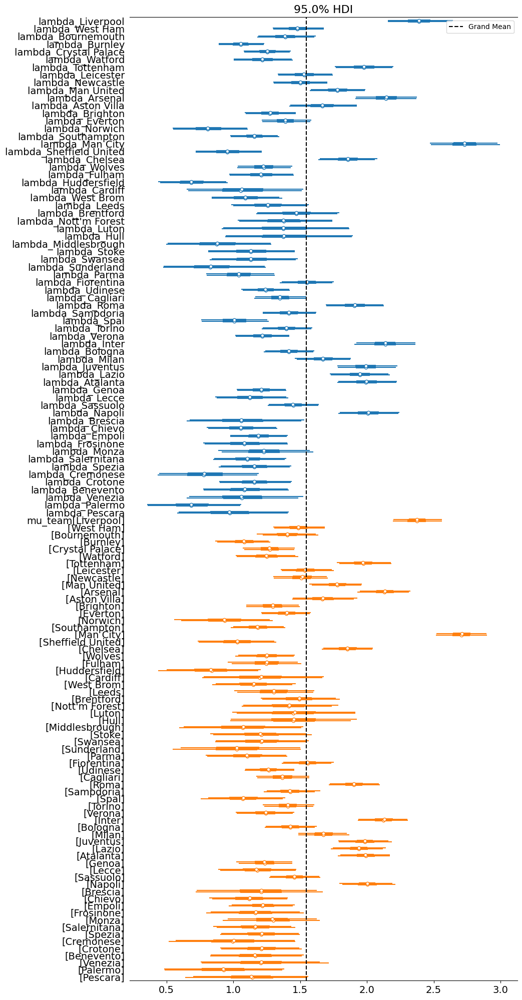

In [230]:
import arviz as az

# Extract the posterior samples for the hierarchical model for the first 10 teams
mu_team_hierarchical = trace_hierarchical.posterior['mu_team']

# Slice the hierarchical posterior for only the first 10 teams (mu_team_dim_0)
mu_team_hierarchical_10 = mu_team_hierarchical  # First 10 teams

# Convert the hierarchical posterior for the first 10 teams to a 2D array (flattened over chains and draws)
mu_team_hierarchical_flat_10 = mu_team_hierarchical_10.values.flatten()

# Get the team names for the first 10 teams
team_names_10 = mu_team_hierarchical.coords['mu_team_dim_0'].values

# For the unpooled model, extract the 'lambda_{team}' values for the first 10 teams
lambda_unpooled = [f'lambda_{team}' for team in team_names_10]

# Now, slice the unpooled trace for the first 10 teams only
# If your unpooled model has variable names like 'lambda_TeamName', we slice them as well
lambda_unpooled_10 = [f'lambda_{team}' for team in team_names_10]

# Plot the forest for both the unpooled and hierarchical models for only the first 10 teams
axes = az.plot_forest(
    [unpooled_trace, trace_hierarchical],  # Include both traces: unpooled and hierarchical
    model_names=['Unpooled Model', 'Hierarchical Model'],  # Model names
    combined=False,  # We set this to False to prevent separate rows for both models
    var_names=lambda_unpooled_10 + ['mu_team'],  # Select variables for the first 10 teams
    hdi_prob=0.95,  # Highest Density Interval
    figsize=(10, 25)  # Figure size
)

# Add a vertical line representing the grand mean (you can replace this with any variable)
grand_mean = data["FTHG"].mean()  # Replace with your desired grand mean variable
axes[0].axvline(x=grand_mean, color='black', linestyle='--', label='Grand Mean')

# Show the plot with a legend
axes[0].legend()


In [214]:
print(trace_hierarchical.posterior.coords)


Coordinates:
  * chain          (chain) int64 16B 0 1
  * draw           (draw) int64 16kB 0 1 2 3 4 5 ... 1995 1996 1997 1998 1999
  * mu_team_dim_0  (mu_team_dim_0) object 520B 'Liverpool' ... 'Pescara'


In [215]:
var_names = list(trace_hierarchical.posterior.data_vars)
var_names

['mu_mu', 'mu_team', 'sigma_global', 'sigma_match']